In [64]:
import json
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Load JSON file
with open("all_iris_templates.json", "r") as f:
    data = json.load(f)
    
    # === Load and reshape templates ===

def bitstring_to_array(bitstring):
    """Convert string of '0' and '1' to uint8 NumPy array."""
    return np.array([int(b) for b in bitstring], dtype=np.uint8)

def reshape_iris_code(flat_array):
    """Reshape flat array to (2, 16, 256, 2)"""
    expected_size = 2 * 16 * 256 * 2  # 16384 bits
    if flat_array.size != expected_size:
        raise ValueError(f"Expected {expected_size} bits, got {flat_array.size}")
    return flat_array.reshape((2, 16, 256, 2))

samples = []
bad_entries = 0

for idx, entry in enumerate(data):
    try:
        iris_codes_raw = entry["iris_template"]["iris_codes"]
        mask_codes_raw = entry["iris_template"]["mask_codes"]

        iris_codes = bitstring_to_array(iris_codes_raw)
        mask_codes = bitstring_to_array(mask_codes_raw)

        if iris_codes.size != 2 * 16 * 256 * 2 or mask_codes.size != 2 * 16 * 256 * 2:
            raise ValueError(f"Bad shape at index {idx}")

        iris_codes = reshape_iris_code(iris_codes)
        mask_codes = reshape_iris_code(mask_codes)

        samples.append((iris_codes, mask_codes))

    except Exception as e:
        print(f"[Warning] Skipping entry {idx} due to error: {e}")
        samples.append(None)  # ⬅️ Add placeholder to keep index consistent
        bad_entries += 1

print(f"✅ Loaded {len(samples) - bad_entries} valid samples. Skipped {bad_entries} bad entries.")


[Warning] Skipping entry 148 due to error: 'NoneType' object is not subscriptable
[Warning] Skipping entry 149 due to error: 'NoneType' object is not subscriptable
[Warning] Skipping entry 155 due to error: 'NoneType' object is not subscriptable
[Warning] Skipping entry 239 due to error: 'NoneType' object is not subscriptable
[Warning] Skipping entry 280 due to error: 'NoneType' object is not subscriptable
[Warning] Skipping entry 281 due to error: 'NoneType' object is not subscriptable
[Warning] Skipping entry 282 due to error: 'NoneType' object is not subscriptable
[Warning] Skipping entry 283 due to error: 'NoneType' object is not subscriptable
[Warning] Skipping entry 284 due to error: 'NoneType' object is not subscriptable
[Warning] Skipping entry 285 due to error: 'NoneType' object is not subscriptable
[Warning] Skipping entry 286 due to error: 'NoneType' object is not subscriptable
[Warning] Skipping entry 287 due to error: 'NoneType' object is not subscriptable
[Warning] Skippi

In [65]:
data

[{'folder': '0000',
  'filename': '0000_000.bmp',
  'eye_side': 'left',
  'iris_template': {'iris_codes': '10101000000000000101010101010111111111111110100000010101111111101000010111111111101000000101011111100000011111111111101010101000000000000101011111101000000101010101111111111111111010101010101010101010101010101010000000000000000000000101011111111110101010000000000000000000000010101010101010101010000000000000000000000111111010100000000001010101111111101010100000000101010111111111101010100000000000010101010101010101010101010111111111111110101000000000010101010101011111111111111111110101010101010111111111111010111111101010000000000101010101011111111110101000000101011111111010000001010111111110100000010101111110101010111111111010101010100000000000010101011100000101010111111111111111111111111010101010101010101010101010000000000000000000000101011111111010100000000001010111111010101010101010101010101010101010101010100000000000000000000000000000000001010111111111101010000000010101011111111

In [ ]:
import torch
import numpy as np
import torch.nn.functional as F

def maxpool_iris_code(iris_code_np, kernel_size=(2, 2)):
    """
    Apply 2D MaxPooling to reduce the (2, 16, 256, 2) iris code to (2, 8, 128, 2)
    """
    # iris_code_np shape: (2, 16, 256, 2)
    # We'll treat each (H, W) matrix separately for pooling

    C, H, W, D = iris_code_np.shape
    pooled = []

    for d in range(D):
        x = torch.tensor(iris_code_np[:, :, :, d], dtype=torch.float32)  # Shape: (C, H, W)
        x = F.max_pool2d(x, kernel_size=kernel_size)  # Result: (C, H//2, W//2)
        pooled.append(x.numpy())

    # Stack back the last dimension
    pooled = np.stack(pooled, axis=-1)  # Shape: (C, H//2, W//2, D)
    return pooled

# def minpool_iris_mask(iris_mask_np, kernel_size=(2, 2)):
#     """
#     Apply 2D MaxPooling to reduce the (2, 16, 256, 2) iris code to (2, 8, 128, 2)
#     """
#     # iris_code_np shape: (2, 16, 256, 2)
#     # We'll treat each (H, W) matrix separately for pooling

#     C, H, W, D = iris_mask_np.shape
#     pooled = []

#     for d in range(D):
#         x = torch.tensor(iris_mask_np[:, :, :, d], dtype=torch.float32)  # Shape: (C, H, W)
#         x = - F.max_pool2d(-x, kernel_size=kernel_size)  # Result: (C, H//2, W//2)
#         pooled.append(x.numpy())

#     # Stack back the last dimension
#     pooled = np.stack(pooled, axis=-1)  # Shape: (C, H//2, W//2, D)
#     return pooled

In [67]:
def visualize_iris_code(data, mask_arr):
    """
    Visualizes the iris code and its mask.
    data: (2, 8, 128, 2) iris code
    mask_arr: (2, 8, 128, 2) mask array
    """
    fig, axes = plt.subplots(4, 1, figsize=(12, 6))

    titles = [
        "(0,0)  # filter 0, real",
        "(0,1)  # filter 0, imaginary",
        "(1,0)  # filter 1, real",
        "(1,1)  # filter 1, imaginary",
    ]

    for i, (filter_idx, channel_idx) in enumerate([(0, 0), (0, 1), (1, 0), (1, 1)]):
        image = data[filter_idx, :, :, channel_idx]
        mask = mask_arr[filter_idx, :, :, channel_idx]

        axes[i].imshow(image, cmap="gray", aspect="auto")
        axes[i].imshow(1 - mask, cmap="Reds", alpha=0.3, aspect="auto")  # Invalid = red
        axes[i].set_title(titles[i])
        axes[i].axis("off")

    plt.subplots_adjust(hspace=0.6)
    plt.show()

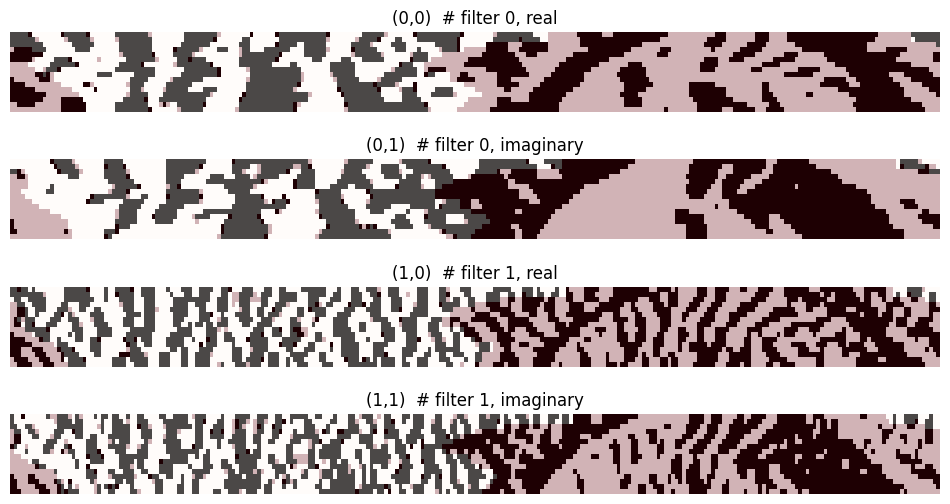

In [68]:
import numpy as np
import matplotlib.pyplot as plt

# Choose a sample to visualize
sample_idx = 100 # Change this to 1 or 2 for other samples
iris_template, mask_arr = samples[sample_idx]

visualize_iris_code(iris_template, mask_arr)

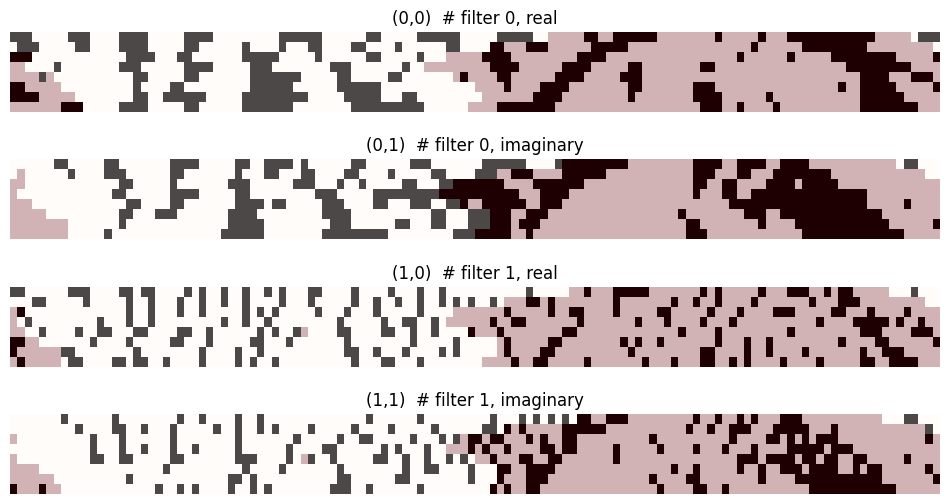

In [69]:
data_lowRes, mask_lowRes = maxpool_iris_code(iris_template), maxpool_iris_code(mask_arr)
visualize_iris_code(data_lowRes, mask_lowRes)

In [70]:
def binary_str_to_numpy(binary_str, shape):
    expected_len = np.prod(shape)
    if not binary_str or len(binary_str) != expected_len:
        raise ValueError(f"Expected binary string of length {expected_len}, got {len(binary_str)}")
    flat = np.array(list(binary_str), dtype=np.uint8)
    return flat.reshape(shape)

def numpy_to_binary_str(arr):
    flat = arr.astype(np.uint8).flatten()
    return ''.join(map(str, flat))

def process_template(template, index):
    original_shape = (2, 16, 256, 2)
    try:
        iris_codes = template.get("iris_codes")
        mask_codes = template.get("mask_codes")

        if iris_codes is None or mask_codes is None:
            raise ValueError("Missing iris_codes or mask_codes")

        iris_code_np = binary_str_to_numpy(iris_codes, original_shape)
        mask_code_np = binary_str_to_numpy(mask_codes, original_shape)

        pooled_iris = maxpool_iris_code(iris_code_np)
        pooled_mask = maxpool_iris_code(mask_code_np)

        template["iris_codes"] = numpy_to_binary_str(pooled_iris)
        template["mask_codes"] = numpy_to_binary_str(pooled_mask)

        return template
    except Exception as e:
        print(f"[Index {index}] Error processing iris_template: {e}")
        return None


In [71]:
output_filename = "iris_template_pooled_maxpool_mask.json"

processed_data = []

for idx, item in enumerate(data):
    try:
        template = item.get("iris_template")
        processed_template = process_template(template, idx)
        item["iris_template"] = processed_template  # ⬅️ Will be set to None if failed
        processed_data.append(item)
    except Exception as e:
        print(f"[Index {idx}] Unexpected error: {e}")
        item["iris_template"] = None
        processed_data.append(item)

if processed_data:
    with open(output_filename, "w") as f:
        json.dump(processed_data, f, indent=2)
    print(f"\n✅ Processed {len(processed_data)} entries. Output saved to '{output_filename}'")
else:
    print("❌ No valid entries to save.")

[Index 148] Error processing iris_template: 'NoneType' object has no attribute 'get'
[Index 149] Error processing iris_template: 'NoneType' object has no attribute 'get'
[Index 155] Error processing iris_template: 'NoneType' object has no attribute 'get'
[Index 239] Error processing iris_template: 'NoneType' object has no attribute 'get'
[Index 280] Error processing iris_template: 'NoneType' object has no attribute 'get'
[Index 281] Error processing iris_template: 'NoneType' object has no attribute 'get'
[Index 282] Error processing iris_template: 'NoneType' object has no attribute 'get'
[Index 283] Error processing iris_template: 'NoneType' object has no attribute 'get'
[Index 284] Error processing iris_template: 'NoneType' object has no attribute 'get'
[Index 285] Error processing iris_template: 'NoneType' object has no attribute 'get'
[Index 286] Error processing iris_template: 'NoneType' object has no attribute 'get'
[Index 287] Error processing iris_template: 'NoneType' object has